# Getting to know OOIPY
<img src="https://ooipy.readthedocs.io/en/latest/_images/OOIPY_Logo.png" width="100">

The documentation can be found [here](https://ooipy.readthedocs.io/en/latest/)

In [1]:
import ooipy
from datetime import datetime
from IPython.display import Audio
import matplotlib.pyplot as plt
import numpy as np
import hvplot.xarray
import xarray as xr
import pandas as pd

### download broadband hydrophone data
- using `ooipy.get_acoustic_data` download a section of hydrophone data
    - data section

In [3]:
starttime=datetime(2019,1,12,3)
endtime=datetime(2019,1,12,3,2)#2 minutes later
node = 'LJ01C' #oregon offshore

hdata = ooipy.get_acoustic_data(starttime, endtime, node, verbose=True)

Fetching URLs...
Sorting valid URLs for Time Window...
100%|██████████| 4/4 [00:02<00:00,  1.62it/s]
file fragmented but timestamps are unique. Segment kept
Merging 4 Traces...
Data has Gaps


   - downloads the relevant mseed files from the HTTP raw data server, and combines individual mseed files into a continuous data stream
   - If you are on Jupyter Hub, you can instead pull the data from the mounted ooi data directory
        - this allows you to pull in larger data (it's not going through the network)

In [4]:
starttime=datetime(2019,1,12,3)
endtime=datetime(2019,1,12,4)
node = 'LJ01C'

hdata_jhub = ooipy.get_acoustic_data(starttime, endtime, node, verbose=True, jupyter_hub=True)

Fetching URLs...
Sorting valid URLs for Time Window...
100%|██████████| 15/15 [00:02<00:00,  5.37it/s]
file fragmented but timestamps are unique. Segment kept
file fragmented but timestamps are unique. Segment kept
Merging 15 Traces...
Data has Gaps


In [5]:
len(hdata_jhub.data)*8*1e-9 #roughly how many gigabytes

1.8432000080000002

In [37]:
type(hdata)

ooipy.hydrophone.basic.HydrophoneData

### exploring the `ooipy.HydrophoneData` Object

#### obspy Trace methods
- wraps the `obspy.Trace` class (so it has all of the functionality of obspy traces)
   - plotting
   - decimation

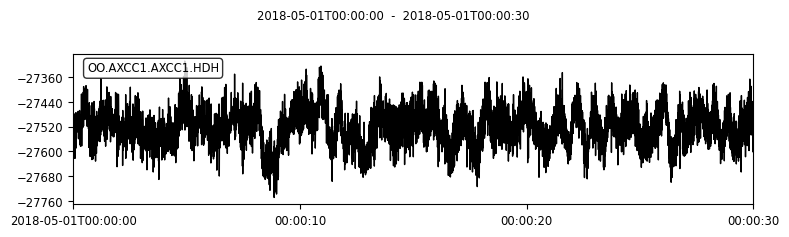

In [43]:
st = hdata.stats.starttime


_ = hdata.plot(starttime=st,endtime=st+30)

In [8]:
starttime=datetime(2019,1,12,3)
endtime=datetime(2019,1,12,3,2)
node = 'LJ01C'

hdata_temp = ooipy.get_acoustic_data(starttime, endtime, node, verbose=True)
hdata_temp.decimate(8)

Fetching URLs...
Sorting valid URLs for Time Window...
100%|██████████| 4/4 [00:02<00:00,  1.58it/s]
file fragmented but timestamps are unique. Segment kept
Merging 4 Traces...
Data has Gaps


OO.HYEA1.LJ01C.YDH | 2019-01-12T02:59:59.999999Z - 2019-01-12T03:01:59.999999Z | 8000.0 Hz, 960001 samples

In [9]:
hdata_temp

OO.HYEA1.LJ01C.YDH | 2019-01-12T02:59:59.999999Z - 2019-01-12T03:01:59.999999Z | 8000.0 Hz, 960001 samples

#### estimate power spectral density

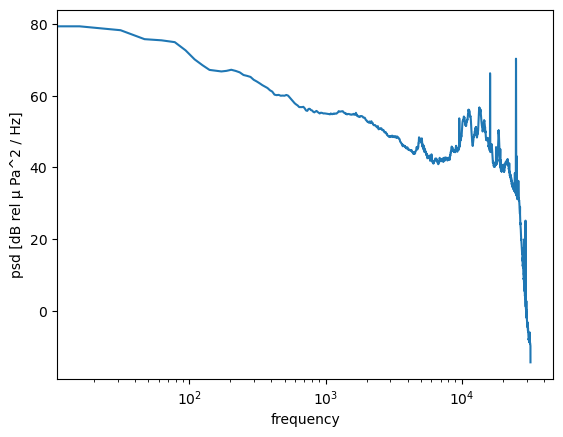

In [11]:
psd = hdata.compute_psd_welch()
psd.plot()
plt.xscale('log')

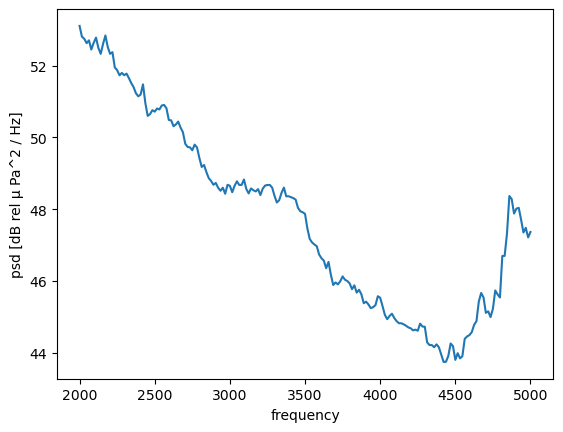

In [17]:
psd.loc[2000:5000].plot()

#### compute spectrograms
(Using PSD estimates)

In [12]:
spec = hdata.compute_spectrogram()

In [13]:
spec

<xarray.DataArray 'spectrogram' (time: 3749, frequency: 2049)> Size: 61MB
array([[ 55.80624686,  74.03892186,  75.57499619, ..., -15.58494622,
         -6.96998534,  -9.67793081],
       [ 55.4765231 ,  68.08278354,  74.69359497, ...,  -3.73063002,
        -14.55046704, -26.56247797],
       [ 64.13841688,  59.60932625,  75.35807435, ..., -33.94378687,
        -14.03791326, -15.22338612],
       ...,
       [ 65.95339441,  81.80123283,  81.79793474, ...,  -7.15316104,
         -8.41103906, -12.97329056],
       [ 73.90310279,  79.15519446,  73.96420994, ...,  -6.10930907,
         -9.8644945 , -13.17215318],
       [ 71.55022362,  77.74113413,  71.02454301, ...,  -9.5045714 ,
         -3.56540029,  -6.06274133]], shape=(3749, 2049))
Coordinates:
  * time       (time) datetime64[ns] 30kB 2019-01-12T02:59:59.999999 ... 2019...
  * frequency  (frequency) float64 16kB 0.0 15.62 31.25 ... 3.198e+04 3.2e+04
Attributes:
    start_time:  2019-01-12 02:59:59.999999
    end_time:    2019-01-12 03:01:59.999999
    nperseg:     4096
    units:       dB rel µ Pa^2 / Hz

(0.0, 5000.0)

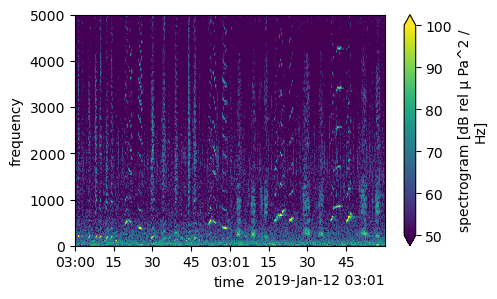

In [21]:
fig = plt.figure(figsize=(5,3))
spec.plot(x='time', vmax=100, vmin=50)
plt.ylim([0,5000])

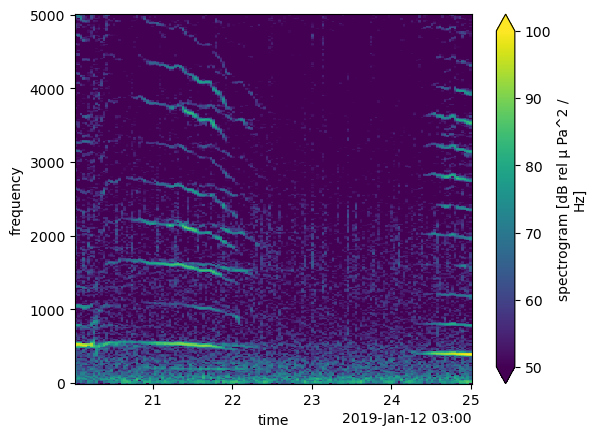

In [28]:
starttime = pd.Timestamp('2019-01-12 T03:00:20')
endtime = pd.Timestamp('2019-01-12 T03:00:25')

spec.loc[starttime:endtime, 0:5000].plot(x='time', vmax=100, vmin=50)

In [14]:
spec.hvplot.image(x='time', clim=(30,90), rasterize=True)

:DynamicMap   []
   :Image   [time,frequency]   (spectrogram)

#### Playing with xarray a little bit
- let's take a little bit of time to familiarize ourselves with xarray

In [ ]:
spec_large = hdata_jhub.compute_spectrogram()

In [ ]:
spec_large

In [ ]:
spec_large.hvplot(rasterize=True)

- you can slice the dataset with coordinate values

In [ ]:
spec_slice = (
    spec_large
    .sel({'time':slice(pd.Timestamp('2019-01-12 T03:30:00'), pd.Timestamp('2019-01-12 T03:32:00'))})
    .sel({'frequency':slice(1000,10000)})
)

#### listen to audio in notebook

In [29]:
Audio(hdata.data, rate=64e3) #humpback whale!

#### save data to file

In [ ]:
hdata.save(file_format='nc', filename='LJ01C_20190112')

In [ ]:
xr.open_dataarray('LJ01C_20190112.nc').plot()

## Download Low Frequency Data with ooipy

In [ ]:
import ooipy
from datetime import datetime

In [31]:
starttime = datetime(2018,5,1)
endtime = datetime(2018,5,1,1)
node='AXCC1'

hdata = ooipy.get_acoustic_data_LF(starttime, endtime, node, verbose=True) #LF for low freq

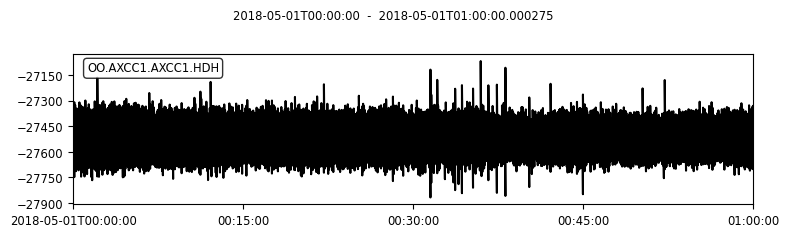

In [32]:
_ = hdata.plot()

In [33]:
spec = hdata.compute_spectrogram()

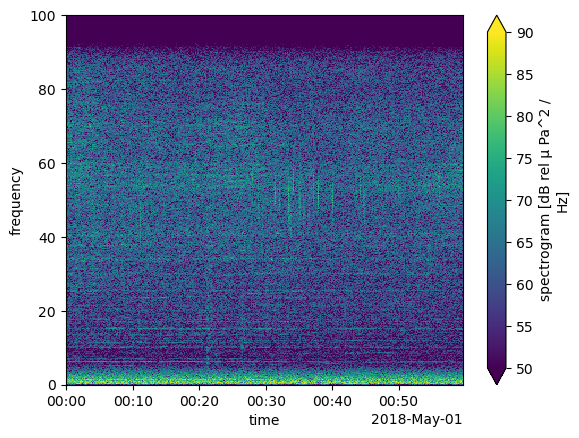

In [34]:
spec.plot(x='time', vmax=90, vmin=50)

In [35]:
spec

<xarray.DataArray 'spectrogram' (time: 350, frequency: 2049)> Size: 6MB
array([[ 67.69466481,  63.43322839,  55.02653452, ...,  21.91047599,
         25.03807744,  22.27568768],
       [ 55.58436211,  51.96787548,  47.16581531, ...,  18.86487574,
         16.8462198 , -12.0556215 ],
       [ 70.04165845,  65.36067657,  61.82452055, ...,  18.26954192,
         16.8949421 ,  15.55625902],
       ...,
       [ 60.15945315,  57.46183341,  50.96093705, ...,  20.18045874,
         19.32934492,  10.18602784],
       [ 69.08189396,  63.98532442,  66.90713701, ...,  26.47613866,
         20.40055827,  12.60459865],
       [ 60.1693497 ,  58.6260719 ,  64.74501324, ...,  20.7799161 ,
          7.44205518,   9.86742726]], shape=(350, 2049))
Coordinates:
  * time       (time) datetime64[ns] 3kB 2018-05-01 ... 2018-05-01T00:59:33.7...
  * frequency  (frequency) float64 16kB 0.0 0.04883 0.09766 ... 99.9 99.95 100.0
Attributes:
    start_time:  2018-05-01 00:00:00
    end_time:    2018-05-01 01:00:00.000275
    nperseg:     4096
    units:       dB rel µ Pa^2 / Hz